In [140]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import xarray as xr
from datetime import datetime
import act
import glob
import os
import netCDF4
from imutils.perspective import four_point_transform
from imutils import contours
import imutils
import cv2
from scipy.ndimage import gaussian_filter
import pywt
%matplotlib inline

In [2]:
# read in files for day of interest
try:
    ds = xr.open_dataset('case1.nc')
    print('opened file')
except:
    file_list = glob.glob("case1/*.nc")
    ds = xr.open_mfdataset(file_list, combine = 'by_coords')
    ds.sortby('time')

    # Variables to correct
    variables = ['beta_att', 'p_pol', 'x_pol', 'linear_depol_ratio']
    
    for var in variables:
        if var != 'linear_depol_ratio':
                ds = act.corrections.correct_ceil(ds, var_name=var)
    
    # Compute linear depolarization ratio
    ds["linear_depol_ratio"] = ds["x_pol"] / (ds["x_pol"] + ds["p_pol"])
    ds.to_netcdf('case1.nc')
    np.save('0801_beta_att', ds['beta_att'].values)

opened file


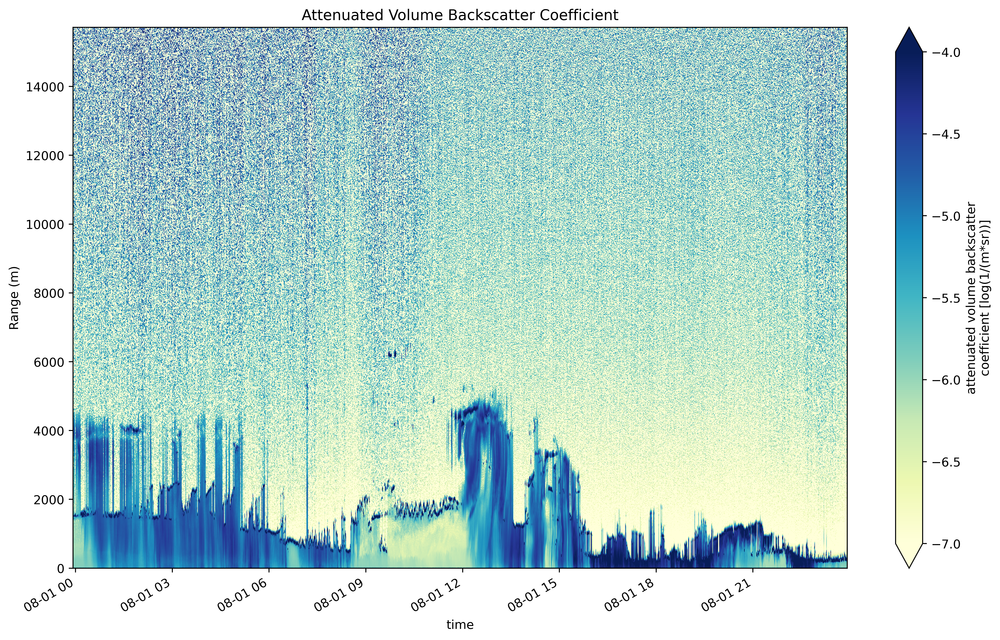

In [3]:
# Create the attenuated backscatter plot
fig = plt.figure(figsize=(12, 8), dpi=500)
plt.rcParams['image.origin'] = 'lower'
ds['beta_att'].plot(
    x='time', y='range',
    cmap='YlGnBu', robust=True,  vmin=-7, vmax=-4
)

ylim = (0,15720)

plt.title('Attenuated Volume Backscatter Coefficient')
plt.ylabel('Range (m)')
plt.ylim(ylim)
plt.xlabel('time')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()
fig.savefig('0801 beta_att')

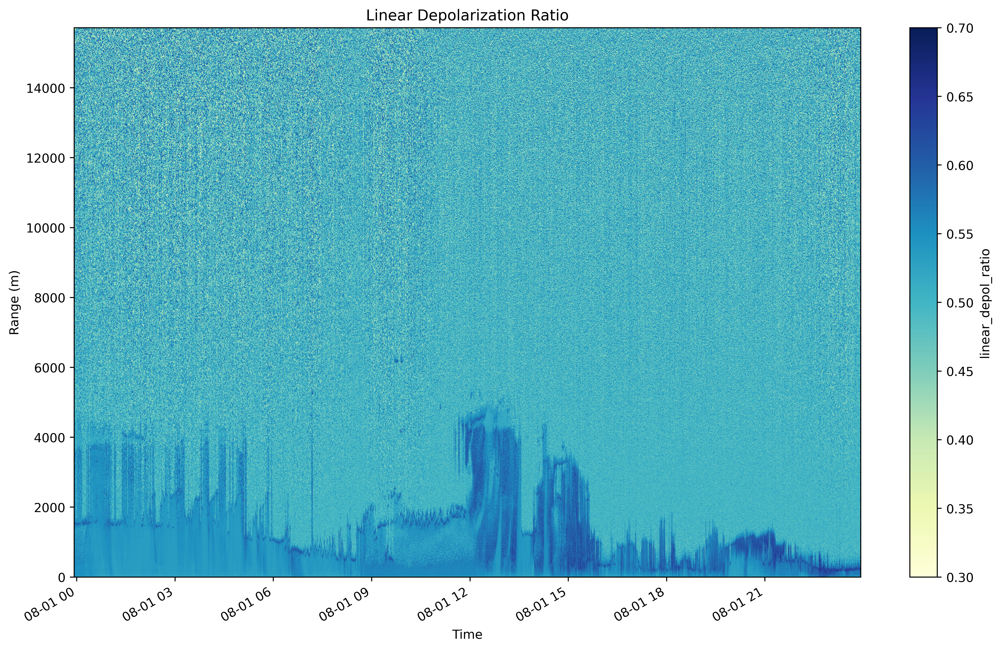

In [4]:
# Plot the figure for linear depolarization

fig = plt.figure(figsize=(12, 8), dpi=500)
ds['linear_depol_ratio'].plot(
    x='time', y='range',
    cmap='YlGnBu', robust=True, vmin = 0.3, vmax = 0.7
)
plt.ylim(ylim)
plt.ylabel('Range (m)')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.title('Linear Depolarization Ratio')
plt.show()

In [5]:
transformed = ds['beta_att'].T.values

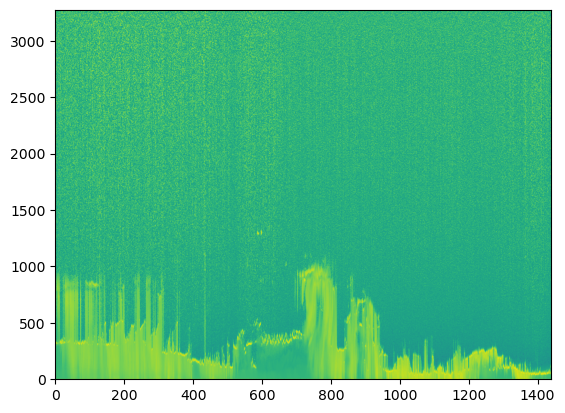

In [6]:
plt.imshow(transformed, aspect='auto')
plt.show()

In [7]:
def atwt2d(data2d, max_scale=-1):
    """
    Computes a trous wavelet transform (ATWT). Computes ATWT of the 2d array
    up to max_scale. If max_scale is outside the boundaries, number of scales
    will be reduced.

    Data is mirrored at the boundaries. 'Negative WT are removed. Not tested
    for non-square data.

    @authors: Bhupendra Raut and Dileep M. Puranik
    @references: Press et al. (1992) Numerical Recipes in C.

    Parameters:
    ===========
    data2d: ndarray
        2D image as array or matrix.
    max_scale:
        Computes wavelets up to max_scale. Leave blank for maximum possible
        scales.

    Returns:
    ========
    wt: ndarray
        ATWT of input image with added 3rd dimention for scales.
    """
    
    if not isinstance(data2d, np.ndarray):
        sys.exit("the input is not a numpy array")
    
    dims = data2d.shape
    min_dims = np.min(dims)
    max_possible_scales = int(np.floor(np.log(min_dims) / np.log(2)))

    if max_scale < 0 or max_possible_scales < max_scale:
        max_scale = max_possible_scales

    ny = dims[0]
    nx = dims[1]    
    wt = np.zeros((max_scale, ny, nx))

    temp1 = np.zeros(dims)
    temp2 = np.zeros(dims)

    sf = (0.0625, 0.25, 0.375)  # scaling function

    # start wavelet loop
    for scale in range(1, max_scale + 1):
        # print(scale)
        x1 = 2 ** (scale - 1)
        x2 = 2 * x1

        # Row-wise smoothing
        for i in range(0, nx):
            # find the indices for prev and next points on the line
            prev2 = abs(i - x2)
            prev1 = abs(i - x1)
            next1 = i + x1
            next2 = i + x2

            # If these indices are outside the image, "mirror" them
            # Sometime this causes issues at higher scales.
            if next1 > nx - 1:
                next1 = 2 * (nx - 1) - next1

            if next2 > nx - 1:
                next2 = 2 * (nx - 1) - next2

            if prev1 < 0 or prev2 < 0:
                prev1 = next1
                prev2 = next2

            for j in range(0, ny):
                left2 = data2d[j, prev2]
                left1 = data2d[j, prev1]
                right1 = data2d[j, next1]
                right2 = data2d[j, next2]
                temp1[j, i] = (sf[0] * (left2 + right2)
                               + sf[1] * (left1 + right1)
                               + sf[2] * data2d[j, i])

        # Column-wise smoothing
        for i in range(0, ny):
            prev2 = abs(i - x2)
            prev1 = abs(i - x1)
            next1 = i + x1
            next2 = i + x2

            # If these indices are outside the image use next values
            if next1 > ny - 1:
                next1 = 2 * (ny - 1) - next1
            if next2 > ny - 1:
                next2 = 2 * (ny - 1) - next2
            if prev1 < 0 or prev2 < 0:
                prev1 = next1
                prev2 = next2

            for j in range(0, nx):
                top2 = temp1[prev2, j]
                top1 = temp1[prev1, j]
                bottom1 = temp1[next1, j]
                bottom2 = temp1[next2, j]
                temp2[i, j] = (sf[0] * (top2 + bottom2)
                               + sf[1] * (top1 + bottom1)
                               + sf[2] * temp1[i, j])

        wt[scale - 1, :, :] = data2d - temp2
        data2d[:] = temp2

    return wt

In [8]:
wavelet = atwt2d(transformed, 8)
img = ds['beta_att'].T.values

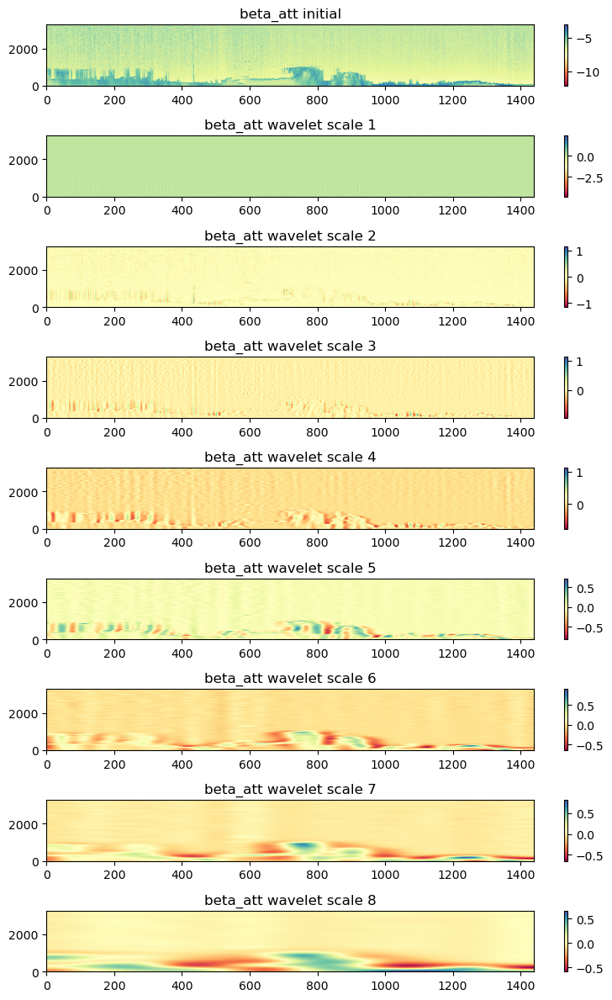

In [9]:
# Plot each extracted wavelet

fig, axes = plt.subplots(9, 1, figsize=(8,12), dpi=100)

for i, ax in enumerate(axes):
    if i == 0:
        im = ax.imshow(img, cmap = 'Spectral', aspect = 'auto')
        ax.set_title(f'beta_att initial')
        fig.colorbar(im, ax=ax)
    else:
        im = ax.imshow(wavelet[i-1], cmap='Spectral', aspect='auto')
        ax.set_title(f'beta_att wavelet scale {i}')
        fig.colorbar(im, ax=ax)

plt.tight_layout()
plt.show()

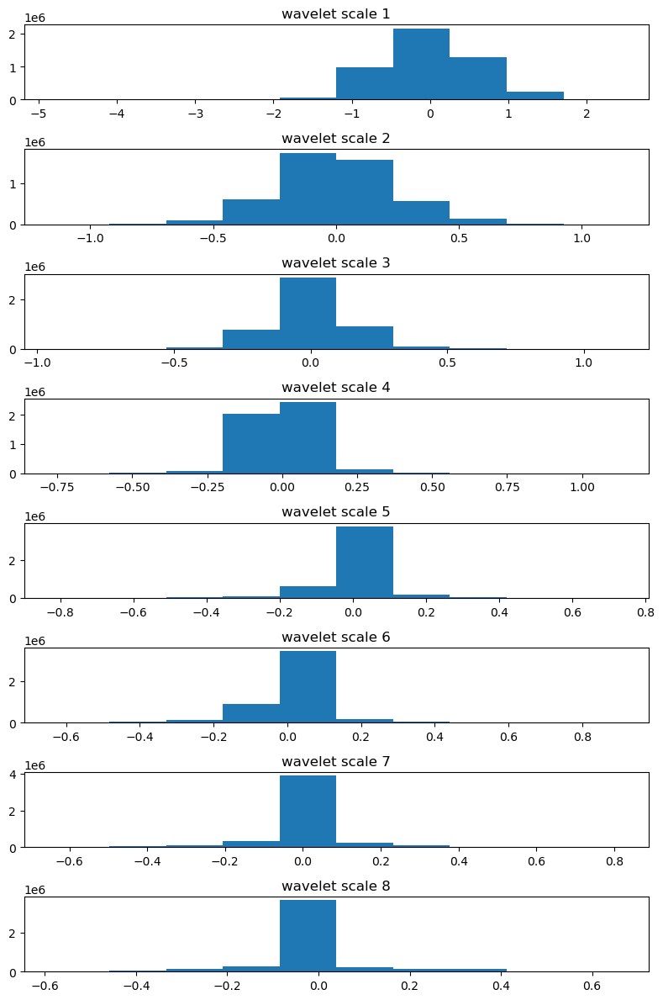

In [10]:
fig, axes = plt.subplots(8, 1, figsize=(8,12))

for i, ax in enumerate(axes):
    ax.hist(wavelet[i].flatten())
    ax.set_title(f'wavelet scale {i+1}')
plt.tight_layout()
plt.show()

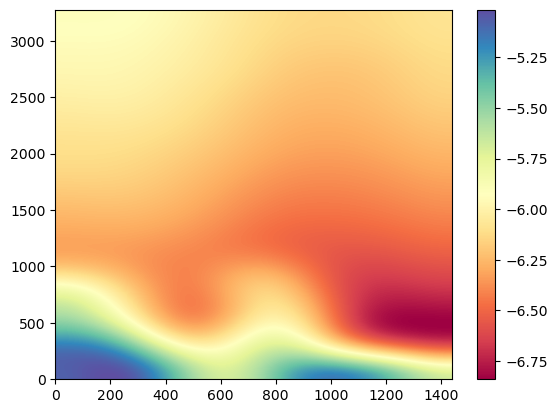

In [11]:
fig = plt.figure()
plt.imshow(transformed, aspect = 'auto', cmap = 'Spectral')
plt.colorbar(
plt.show()
fig.savefig('wavelet_unthresh.png')

In [12]:
transformed_6 = (transformed > -6) * transformed

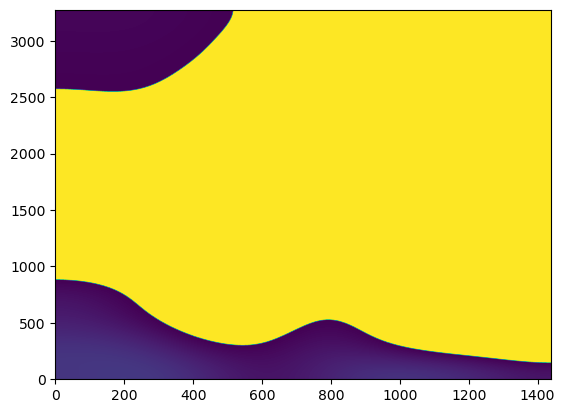

In [13]:
fig = plt.figure()
plt.imshow(transformed_6, aspect = 'auto')
plt.show()

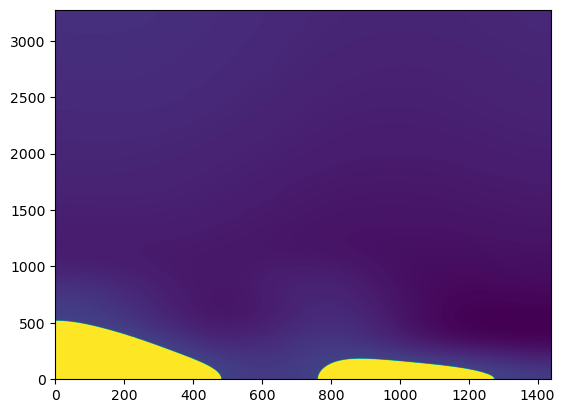

In [14]:
transformed_5half = (transformed < -5.5) * transformed
plt.imshow(transformed_5half, aspect='auto')
plt.show()

In [15]:
normd_img1 = cv2.normalize(transformed_6, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
normd_img2 = cv2.normalize(transformed_5half, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
edged1 = cv2.Canny(normd_img1, 50, 200, apertureSize=5)
edged2 = cv2.Canny(normd_img2, 50, 200, apertureSize=5)

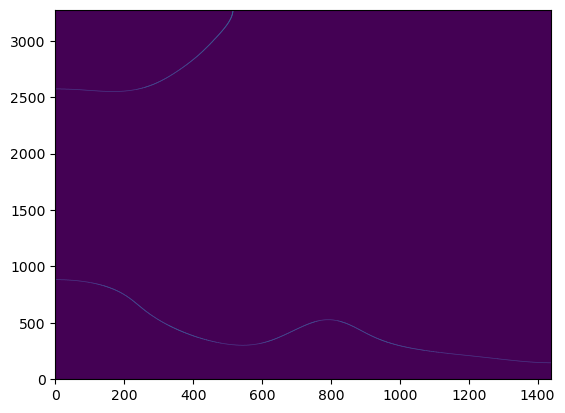

In [16]:
plt.imshow(edged1, aspect='auto')
plt.show()

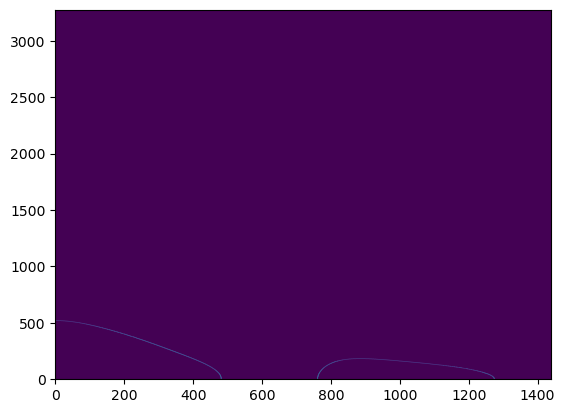

In [17]:
plt.imshow(edged2, aspect='auto')
plt.show()

In [18]:
normalized = cv2.normalize(img, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)

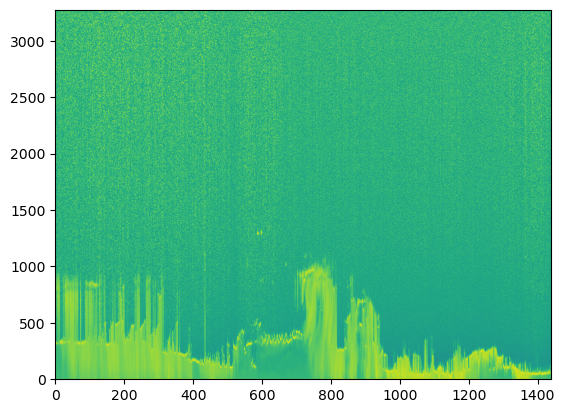

In [19]:
plt.imshow(normalized, aspect = 'auto')
plt.show()

In [20]:
canny_edges = cv2.Canny(normalized,50, 200, apertureSize=3)

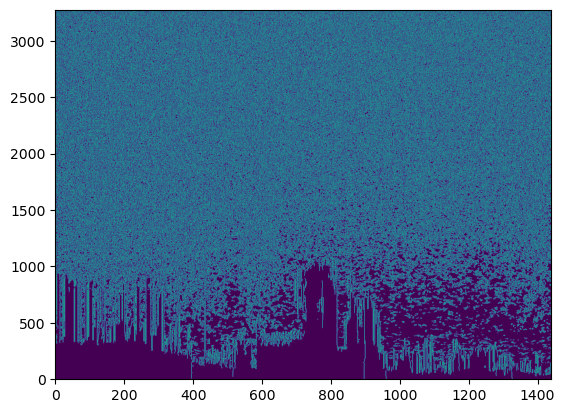

In [21]:
plt.imshow(canny_edges, aspect='auto')
plt.show()

In [22]:
laplacian_edges = cv2.Laplacian(normalized, 50, 200)

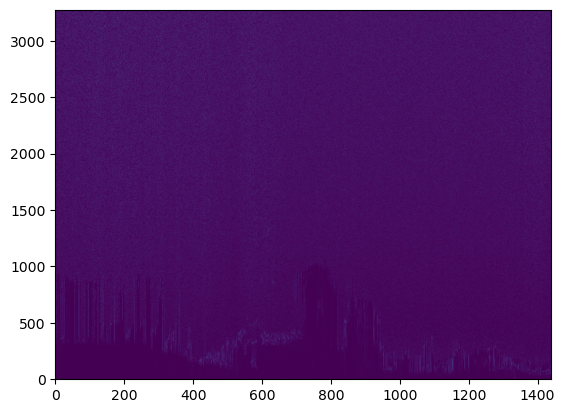

In [23]:
plt.imshow(laplacian_edges, aspect='auto')
plt.show()

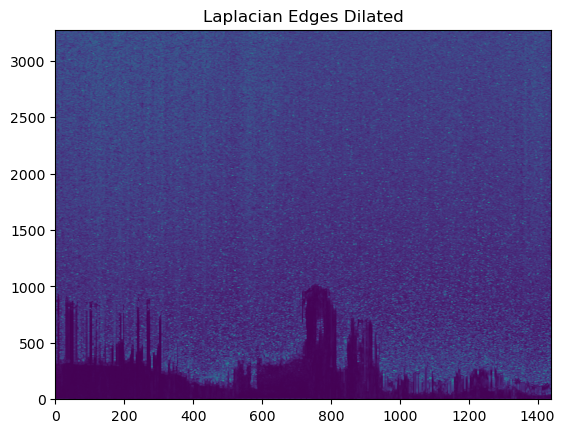

In [24]:
kernel = np.ones((5,5),np.uint8)
laplacian_dilated = cv2.dilate(laplacian_edges,kernel,iterations = 1)
plt.imshow(laplacian_dilated, aspect='auto')
plt.title('Laplacian Edges Dilated')
plt.show()

In [123]:
scale = 1
delta = 0
ddepth = cv2.CV_16S

grad_x = cv2.Sobel(normalized, ddepth, 1, 0, ksize=3, scale=scale, delta=delta, borderType=cv2.BORDER_DEFAULT)
grad_y = cv2.Sobel(normalized, ddepth, 0, 1, ksize=3, scale=scale, delta=delta, borderType=cv2.BORDER_DEFAULT)   
abs_grad_x = cv2.convertScaleAbs(grad_x)
abs_grad_y = cv2.convertScaleAbs(grad_y)
    
 
    
sobel_edged = cv2.addWeighted(abs_grad_x, 0.5, abs_grad_y, 0.5, 0)

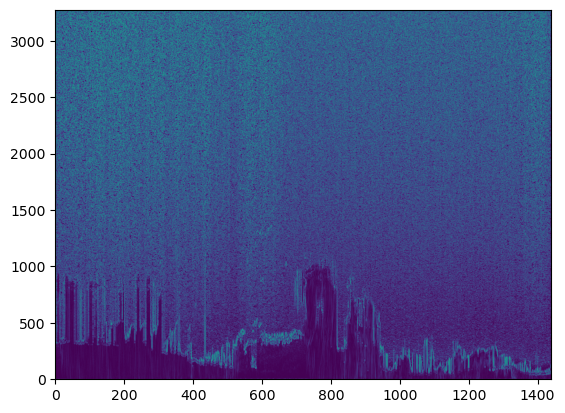

In [26]:
plt.imshow(sobel_edged, aspect = 'auto')
plt.show()

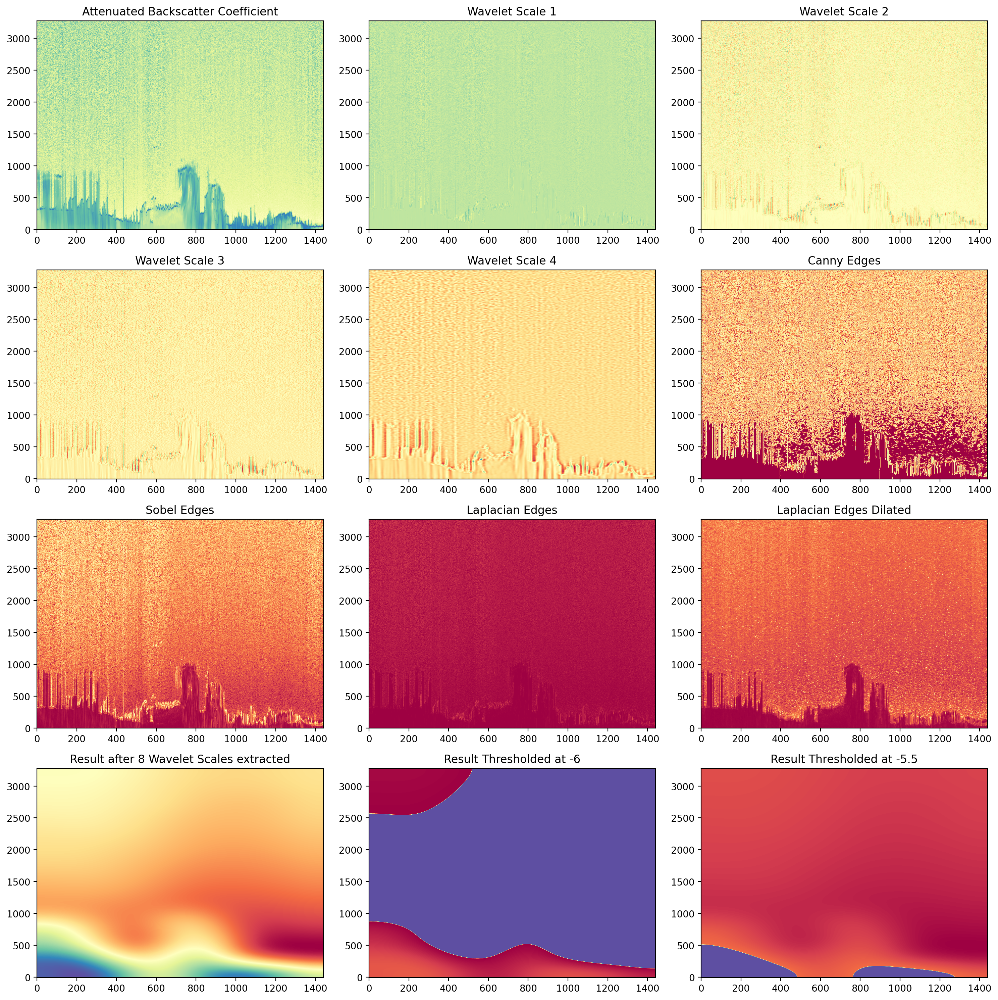

In [188]:
myplots = {'Attenuated Backscatter Coefficient': img,
           'Wavelet Scale 1': wavelet[0],
           'Wavelet Scale 2': wavelet[1],
           'Wavelet Scale 3': wavelet[2],
           'Wavelet Scale 4': wavelet[3],
           'Canny Edges': canny_edges,
           'Sobel Edges': sobel_edged,
           'Laplacian Edges': laplacian_edges,
           'Laplacian Edges Dilated': laplacian_dilated,
           'Result after 8 Wavelet Scales extracted': transformed,
           'Result Thresholded at -6': transformed_6,
           'Result Thresholded at -5.5': transformed_5half
          }

fig, axes = plt.subplots(4, 3, figsize=(15,15), dpi=200)
axes = axes.flatten()
for ax, (name, data) in zip(axes, myplots.items()):
    ax.imshow(data, cmap='Spectral', aspect='auto')
    ax.set_title(name)

fig.tight_layout()
plt.show()
fig.savefig('plot_compilation0801.png')

In [184]:
blurred = cv2.medianBlur(normalized,5)

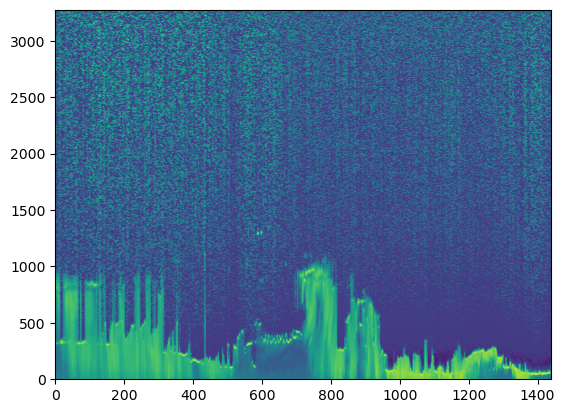

In [185]:
plt.imshow(blurred, aspect='auto')
plt.show()

In [186]:
th2 = cv2.adaptiveThreshold(blurred,255,cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY,11,5)

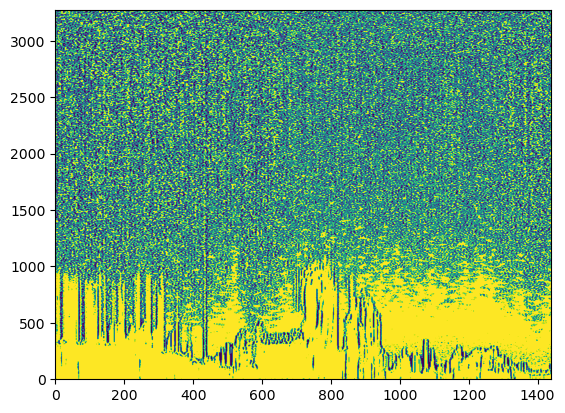

In [178]:
plt.imshow(th2, aspect='auto')
plt.show()

In [66]:
th3 = cv2.adaptiveThreshold(blurred,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,5)

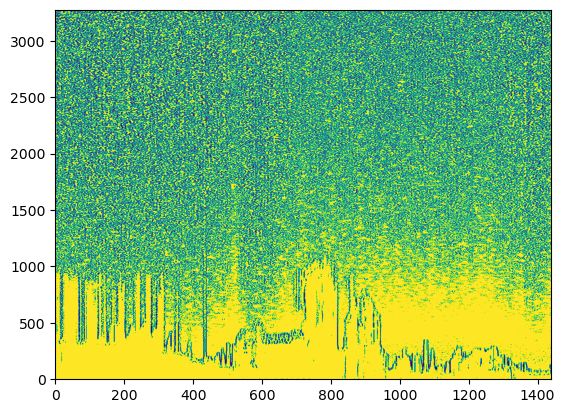

In [67]:
plt.imshow(th3, aspect='auto')
plt.show()

In [115]:
th4 = cv2.threshold(blurred, 200, 255, cv2.THRESH_BINARY)[1]

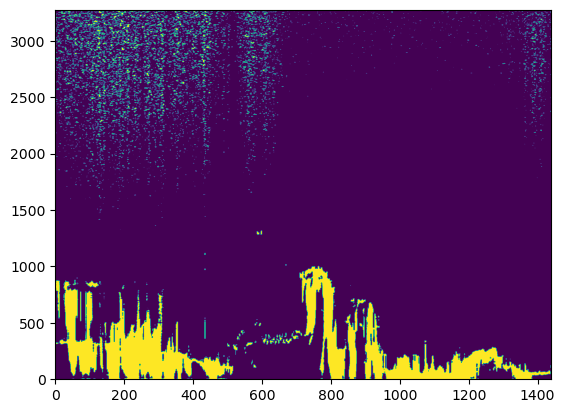

In [116]:
plt.imshow(th4, aspect='auto')
plt.show()

In [121]:
th5 = cv2.threshold(blurred, 220, 255, cv2.THRESH_BINARY)[1]

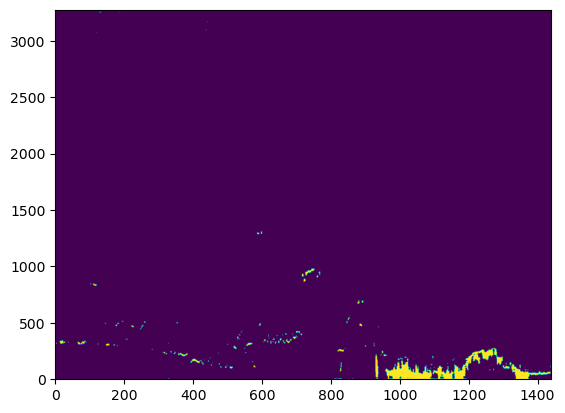

In [122]:
plt.imshow(th5, aspect='auto')
plt.show()

In [130]:
normalized_wave2 =  cv2.normalize(wavelet[1], None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
blurred_wave2 = cv2.medianBlur(normalized_wave2,5)

In [133]:
th6 = cv2.threshold(blurred_wave2, 160, 255, cv2.THRESH_BINARY)[1]

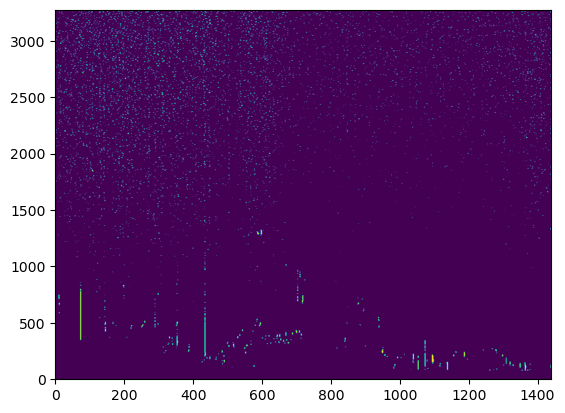

In [134]:
plt.imshow(th6, aspect='auto')
plt.show()

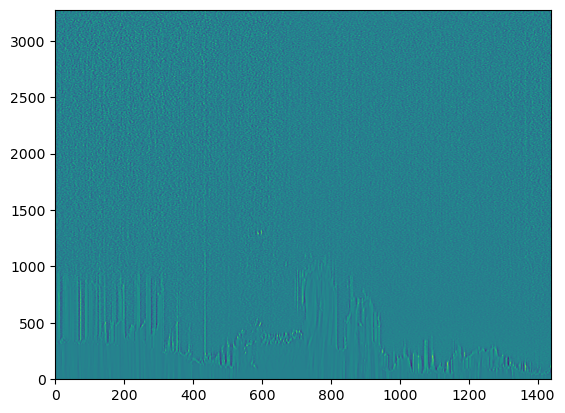

In [136]:
plt.imshow(blurred_wave2, aspect='auto')
plt.show()

In [137]:
th6 = cv2.adaptiveThreshold(blurred_wave2,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,5)

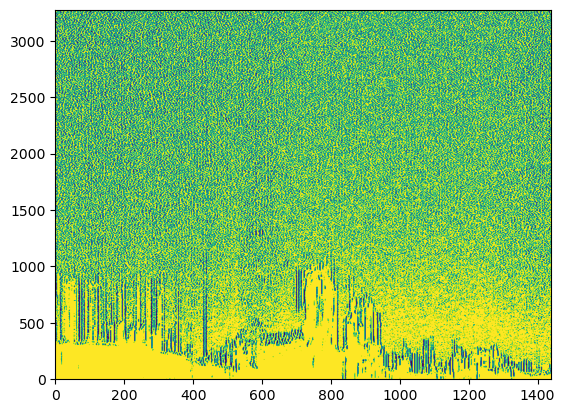

In [138]:
plt.imshow(th6, aspect='auto')
plt.show()

In [154]:
image_foo = ds['beta_att'].T.values

In [194]:
gradient = np.gradient(image_foo, axis=None)

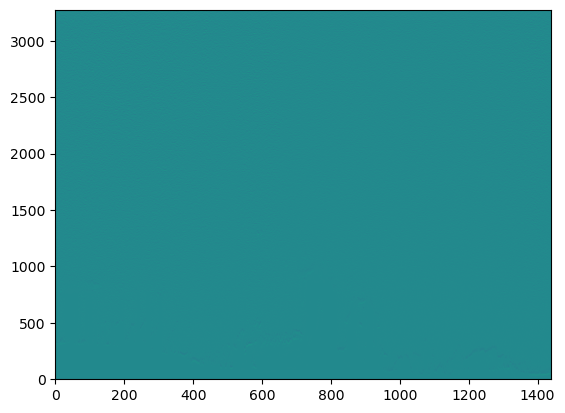

In [195]:
plt.imshow(gradient[0], aspect='auto')
plt.show()

In [196]:
gradient_thresholded = (gradient[0] > 0) * gradient[0]

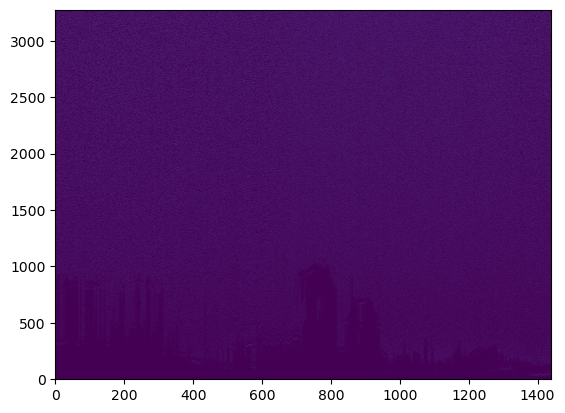

In [197]:
plt.imshow(gradient_thresholded, aspect = 'auto')
plt.show()

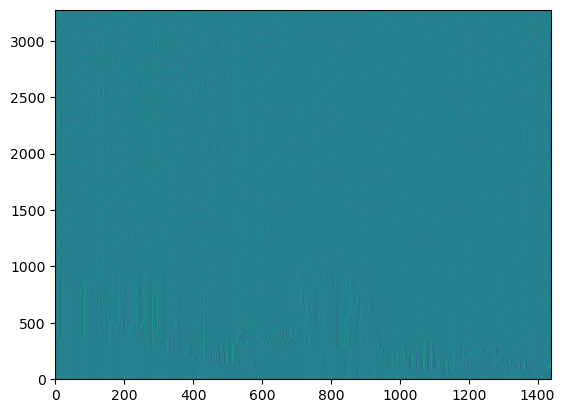

In [198]:
plt.imshow(gradient[1], aspect='auto')
plt.show()

In [199]:
ds['beta_att'].values.shape

(1440, 3276)

In [200]:
ds

<xarray.Dataset>
Dimensions:                            (time: 1440, layer: 5, range: 3276)
Coordinates:
  * time                               (time) datetime64[ns] 2023-07-31T23:55...
  * range                              (range) float64 0.0 4.8 ... 1.572e+04
  * layer                              (layer) float64 1.0 2.0 3.0 4.0 5.0
    longitude                          float64 ...
    latitude                           float64 ...
Data variables: (12/26)
    cloud_base_heights                 (time, layer) float64 ...
    vertical_visibility                (time) float64 ...
    p_pol                              (time, range) float32 ...
    x_pol                              (time, range) float32 ...
    beta_att                           (time, range) float32 -5.077 ... -7.0
    linear_depol_ratio                 (time, range) float32 ...
    ...                                 ...
    fog_detection                      (time) float32 ...
    receiver_gain                      (time) float32 ...
    range_resolution                   (time) float32 ...
    cloud_calibration_factor           (time) float64 ...
    cloud_calibration_factor_user      (time) float64 ...
    overlap_function                   (time, range) float32 ...
Attributes: (12/14)
    title:                          CL61D CL61 with Depolarization
    institution:                    NEIU
    source:                         
    conventions:                    CF-1.8
    schema_version:                 1.3
    sw_version:                     1.2.7
    ...                             ...
    unit:                           m
    instrument_serial_number:       U3810828
    overlap_function_provided:      1
    overlap_is_corrected:           1
    file_temporal_span_in_minutes:  5.0
    profile_interval_in_seconds:    60

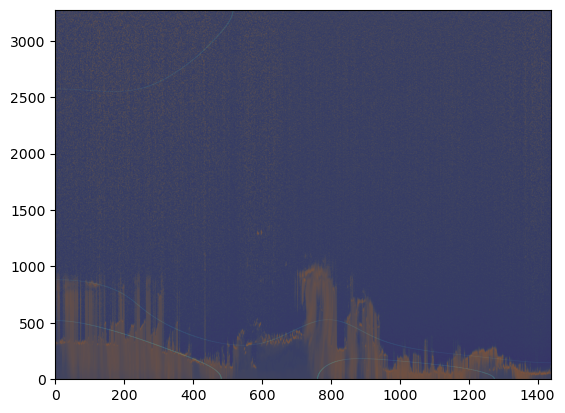

In [217]:
fig, ax = plt.subplots()

# Plot the first set of data
ax.imshow(ds['beta_att'].T.values, aspect='auto')
ax.imshow(edged1, aspect='auto', alpha=0.4)
ax.imshow(edged2, aspect='auto', alpha=0.4)

plt.show()

In [227]:
summ = transformed + wavelet[2] + wavelet[3] + wavelet[4] + wavelet[5] + wavelet[6] + wavelet[7]

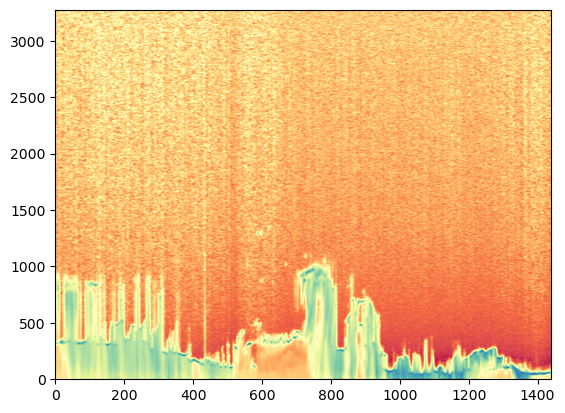

In [228]:
plt.imshow(summ, aspect='auto', cmap='Spectral')
plt.show()

In [229]:
transform_normalized = cv2.normalize(img, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)

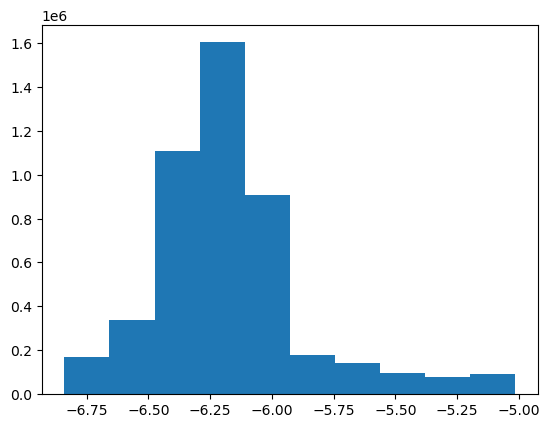

In [230]:
plt.hist(transformed.flatten())
plt.show()

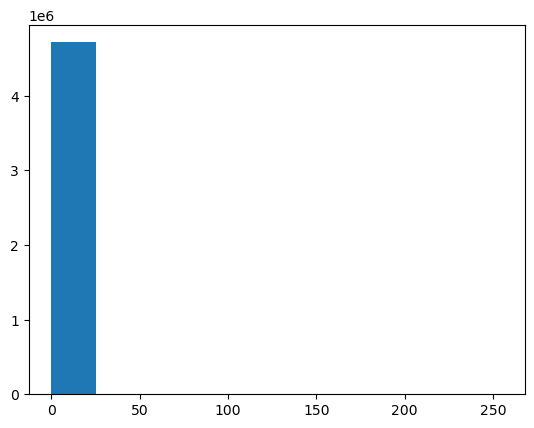

In [233]:
plt.hist(edged1.flatten())
plt.show()

In [234]:
edged1.max()

255

In [236]:
ds['beta_att'].shape

(1440, 3276)